# Lightweight Fine-Tuning Project

TODO: In this cell, describe your choices for each of the following

* PEFT technique: [low-rank adaptation](https://hf.co/papers/2106.09685)
* Model: [google/vit-base-patch16-224](https://huggingface.co/google/vit-base-patch16-224)
* Evaluation approach: classification accuracy
* Fine-tuning dataset: [marmal88/skin_cancer](https://huggingface.co/datasets/marmal88/skin_cancer)

## Loading and Evaluating a Foundation Model

TODO: In the cells below, load your chosen pre-trained Hugging Face model and evaluate its performance prior to fine-tuning. This step includes loading an appropriate tokenizer and dataset.

In [1]:
%env TRANSFORMERS_VERBOSITY=error

import torch, numpy, evaluate, os
from datasets import load_dataset
from PIL import ImageDraw, ImageFont, Image
from peft import LoraConfig, get_peft_model
from torchvision.transforms import CenterCrop, Compose, Normalize, RandomHorizontalFlip, RandomVerticalFlip, RandomResizedCrop, Resize, ToTensor
from transformers import AutoImageProcessor, TrainingArguments, Trainer, ViTForImageClassification

env: TRANSFORMERS_VERBOSITY=error


In [2]:
dataset_path = 'marmal88/skin_cancer'
dataset = load_dataset(dataset_path)
example = dataset['test'][0]
print(example)

{'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=600x450 at 0x7FE05DA86590>, 'image_id': 'ISIC_0024329', 'lesion_id': 'HAM_0002954', 'dx': 'actinic_keratoses', 'dx_type': 'histo', 'age': 75.0, 'sex': 'female', 'localization': 'lower extremity'}


In [3]:
def show_examples(dataset, seed, examples_per_class):

    width, height = dataset['test'][0]['image'].size
    labels = set(dataset['test']['dx'])
    font = ImageFont.load_default(size=24)
    grid = Image.new('RGB', size=(examples_per_class*width, len(labels)*height))
    draw = ImageDraw.Draw(grid)

    for label_idx, label in enumerate(labels):

        dataset_slice = dataset['test'].filter(lambda ex: ex['dx'] == label).shuffle(seed).select(range(examples_per_class))

        for example_idx, example in enumerate(dataset_slice):
            image = example['image']
            idx = examples_per_class * label_idx + example_idx
            box = (idx % examples_per_class * width, idx // examples_per_class * height)
            grid.paste(image, box=box)
            draw.text(box, label, (255, 255, 255), font=font)

    return grid

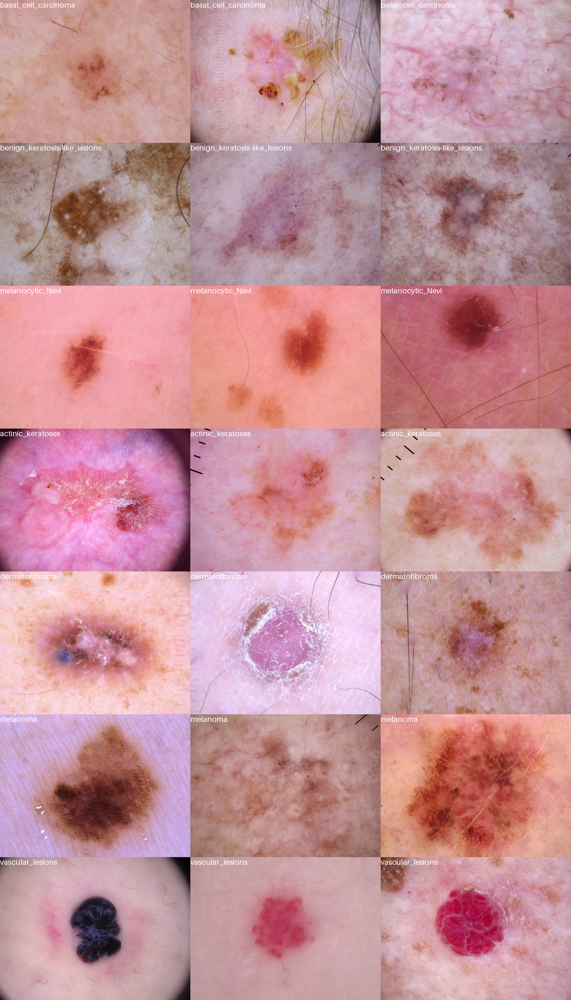

In [4]:
show_examples(dataset, seed=42, examples_per_class=3)

In [5]:
baseline_path = 'google/vit-base-patch16-224'
baseline_processor = AutoImageProcessor.from_pretrained(baseline_path)
baseline_model = ViTForImageClassification.from_pretrained(baseline_path)

In [6]:
def evaluate_examples(dataset, model, image_processor, seed, examples_per_class):

    width, height = dataset['test'][0]['image'].size
    labels = set(dataset['test']['dx'])
    font = ImageFont.load_default(size=24)
    grid = Image.new('RGB', size=(examples_per_class*width, len(labels)*height))
    draw = ImageDraw.Draw(grid)

    for label_idx, label in enumerate(labels):

        dataset_slice = dataset['test'].filter(lambda ex: ex['dx'] == label).shuffle(seed).select(range(examples_per_class))

        for example_idx, example in enumerate(dataset_slice):
            image = example['image']
            idx = examples_per_class * label_idx + example_idx
            box = (idx % examples_per_class * width, idx // examples_per_class * height)
            grid.paste(image, box=box)
            with torch.no_grad():
                output = model(**image_processor(image, return_tensors='pt'))
                inference = model.config.id2label[output.logits.argmax(-1).item()]
            text_color = (0, 255, 0) if inference == example['dx'] else (255, 0, 0)
            draw.text(box, inference, text_color, font=font)

    return grid

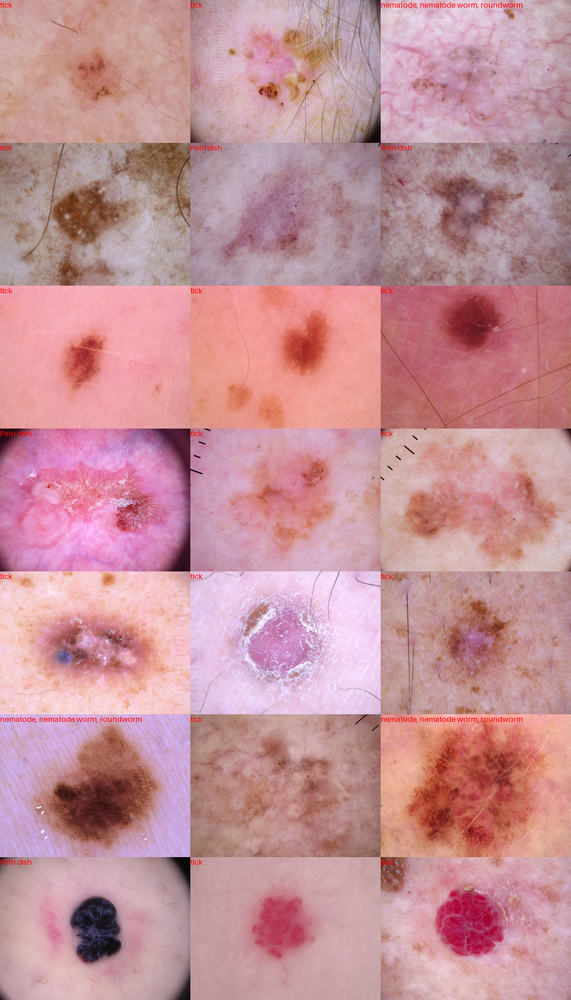

In [7]:
evaluate_examples(dataset, baseline_model, baseline_processor, seed=42, examples_per_class=3)

## Performing Parameter-Efficient Fine-Tuning

TODO: In the cells below, create a PEFT model from your loaded model, run a training loop, and save the PEFT model weights.

In [8]:
labels = set(dataset['test']['dx'])
label2id, id2label = dict(), dict()

for i, label in enumerate(labels):
    label2id[label] = i
    id2label[i] = label

print(id2label, label2id)

{0: 'basal_cell_carcinoma', 1: 'benign_keratosis-like_lesions', 2: 'melanocytic_Nevi', 3: 'actinic_keratoses', 4: 'dermatofibroma', 5: 'melanoma', 6: 'vascular_lesions'} {'basal_cell_carcinoma': 0, 'benign_keratosis-like_lesions': 1, 'melanocytic_Nevi': 2, 'actinic_keratoses': 3, 'dermatofibroma': 4, 'melanoma': 5, 'vascular_lesions': 6}


In [9]:
normalize = Normalize(mean=baseline_processor.image_mean, std=baseline_processor.image_std)
train_transforms = Compose([RandomResizedCrop(baseline_processor.size['height']), RandomHorizontalFlip(), RandomVerticalFlip(), ToTensor(), normalize])
eval_transforms = Compose([Resize(baseline_processor.size['height']), CenterCrop(baseline_processor.size['height']), ToTensor(), normalize])

def preprocess_train(batch):

    batch['pixel_values'] = [train_transforms(image) for image in batch['image']]

    return batch

def preprocess_eval(batch):

    batch['pixel_values'] = [eval_transforms(image) for image in batch['image']]

    return batch

def preprocess_dataset(dataset):

    for split in dataset.keys():
        dataset[split].set_transform(preprocess_train if split=='train' else preprocess_eval)

preprocess_dataset(dataset)

In [10]:
def customize_model(model_path, id2label, label2id, use_lora):

    image_processor = AutoImageProcessor.from_pretrained(model_path)
    model = ViTForImageClassification.from_pretrained(model_path, id2label=id2label, label2id=label2id, num_labels=len(id2label), ignore_mismatched_sizes=True)

    if use_lora:
        config = LoraConfig(r=16, lora_alpha=16, target_modules=['query', 'value'], lora_dropout=0.1, bias='none', modules_to_save=['classifier'])
        model = get_peft_model(model, config)

    return model, image_processor

In [11]:
lora_model, lora_processor = customize_model(baseline_path, id2label, label2id, True)
print(lora_model)
lora_model.print_trainable_parameters()

PeftModel(
  (base_model): LoraModel(
    (model): ViTForImageClassification(
      (vit): ViTModel(
        (embeddings): ViTEmbeddings(
          (patch_embeddings): ViTPatchEmbeddings(
            (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
          )
          (dropout): Dropout(p=0.0, inplace=False)
        )
        (encoder): ViTEncoder(
          (layer): ModuleList(
            (0-11): 12 x ViTLayer(
              (attention): ViTAttention(
                (attention): ViTSelfAttention(
                  (query): lora.Linear(
                    (base_layer): Linear(in_features=768, out_features=768, bias=True)
                    (lora_dropout): ModuleDict(
                      (default): Dropout(p=0.1, inplace=False)
                    )
                    (lora_A): ModuleDict(
                      (default): Linear(in_features=768, out_features=16, bias=False)
                    )
                    (lora_B): ModuleDict(
                      

In [12]:
def collate_function(samples):

    pixel_values = torch.stack([s['pixel_values'] for s in samples])
    labels = torch.tensor([label2id[s['dx']] for s in samples])

    return {'pixel_values': pixel_values, 'labels': labels}

def compute_metrics(outputs):

    metric = evaluate.load('accuracy')
    predictions = numpy.argmax(outputs.predictions, axis=1)

    return metric.compute(predictions=predictions, references=outputs.label_ids)

def create_trainer(train_dataset, eval_dataset, model, tokenizer, output_dir):

    train_args = TrainingArguments(output_dir=output_dir,
                                   remove_unused_columns=False,
                                   evaluation_strategy='epoch',
                                   save_strategy='epoch',
                                   learning_rate=5e-3,
                                   per_device_train_batch_size=128,
                                   gradient_accumulation_steps=4,
                                   per_device_eval_batch_size=128,
                                   fp16=False,
                                   num_train_epochs=30,
                                   logging_strategy='epoch',
                                   load_best_model_at_end=True,
                                   metric_for_best_model='accuracy',
                                   push_to_hub=False,
                                   label_names=['labels'])

    return Trainer(model, train_args, train_dataset=train_dataset, eval_dataset=eval_dataset, tokenizer=tokenizer, compute_metrics=compute_metrics, data_collator=collate_function)

In [13]:
trainer = create_trainer(dataset['train'], dataset['validation'], lora_model, lora_processor, os.path.join('models', f'{baseline_path.split("/")[-1]}-{dataset_path.split("/")[-1]}'))
train_results = trainer.train()
release_path = os.path.join(trainer.args.output_dir, 'release')
trainer.save_model(release_path)

{'loss': 0.913, 'grad_norm': 1.381813406944275, 'learning_rate': 0.004833333333333334, 'epoch': 0.96}
{'eval_loss': 0.546656608581543, 'eval_accuracy': 0.8085874799357945, 'eval_runtime': 30.2774, 'eval_samples_per_second': 82.306, 'eval_steps_per_second': 0.661, 'epoch': 0.96}
{'loss': 0.514, 'grad_norm': 1.5127874612808228, 'learning_rate': 0.004657407407407408, 'epoch': 1.97}
{'eval_loss': 0.4172016382217407, 'eval_accuracy': 0.8386837881219904, 'eval_runtime': 27.4265, 'eval_samples_per_second': 90.861, 'eval_steps_per_second': 0.729, 'epoch': 1.97}
{'loss': 0.4142, 'grad_norm': 0.6093388795852661, 'learning_rate': 0.004481481481481481, 'epoch': 2.99}
{'eval_loss': 0.3423815667629242, 'eval_accuracy': 0.872792937399679, 'eval_runtime': 27.1216, 'eval_samples_per_second': 91.882, 'eval_steps_per_second': 0.737, 'epoch': 2.99}
{'loss': 0.3665, 'grad_norm': 0.905277669429779, 'learning_rate': 0.0043055555555555555, 'epoch': 4.0}
{'eval_loss': 0.30229905247688293, 'eval_accuracy': 0.89

## Performing Inference with a PEFT Model

TODO: In the cells below, load the saved PEFT model weights and evaluate the performance of the trained PEFT model. Be sure to compare the results to the results from prior to fine-tuning.

In [14]:
tester = create_trainer(None, dataset['test'], baseline_model, baseline_processor, './')
baseline_test_results = tester.evaluate()

{'eval_loss': 7.719064712524414, 'eval_accuracy': 0.0007782101167315176, 'eval_runtime': 13.707, 'eval_samples_per_second': 93.748, 'eval_steps_per_second': 0.803}


In [15]:
release_model, release_processor = customize_model(release_path, id2label, label2id, False)
tester = create_trainer(None, dataset['test'], release_model, release_processor, release_path)
release_test_results = tester.evaluate()

{'eval_loss': 0.04309343546628952, 'eval_accuracy': 0.9859922178988327, 'eval_runtime': 24.0829, 'eval_samples_per_second': 53.357, 'eval_steps_per_second': 0.457}


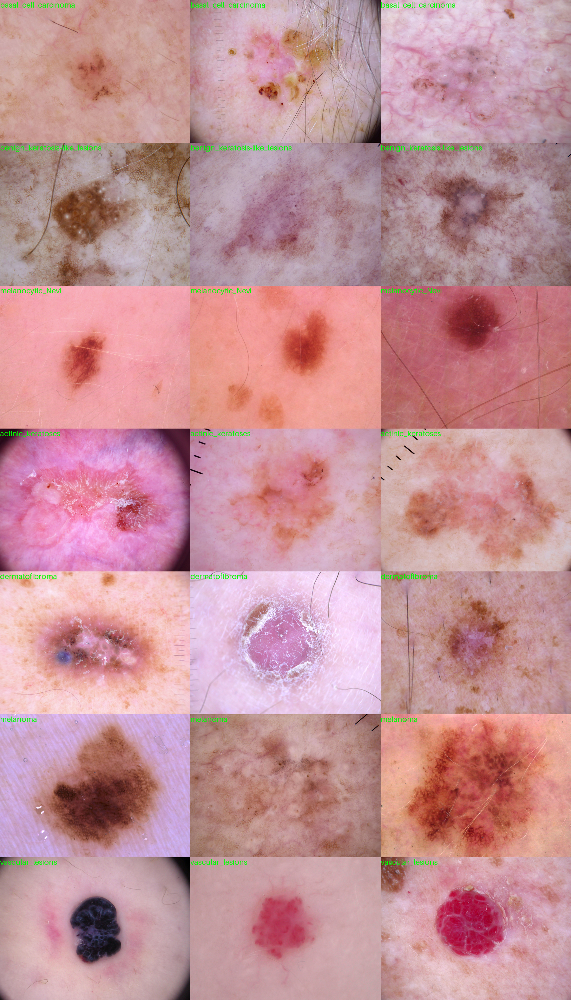

In [16]:
dataset = load_dataset(dataset_path)
evaluate_examples(dataset, release_model.to('cpu'), release_processor, seed=42, examples_per_class=3)